#Порівняння моделей для класифікації мінералів за допомогою Inception

In [1]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import load_img, img_to_array
import zipfile
from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [4]:
import zipfile

# Розархівування набору даних
local_zip = './minerals.zip'  # Назва вашого архіву
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('./base_minerals')  # Шлях для розархівованих даних
zip_ref.close()

In [5]:
import os
import random
import shutil

# Шляхи до вихідного і цільового набору даних
original_dataset_dir = './base_minerals/minerals'
base_dir = 'minerals_gen'
test_dir = os.path.join(base_dir, 'test')

# Створення базової папки для даних, якщо вона не існує
if not os.path.exists(base_dir):
    os.makedirs(base_dir)

# Створення папки test
if not os.path.exists(test_dir):
    os.makedirs(test_dir)

# Процент для тестової вибірки
test_split = 0.2

# Розподіл даних
for class_name in os.listdir(original_dataset_dir):
    class_path = os.path.join(original_dataset_dir, class_name)

    # Перевіряємо, чи це директорія
    if os.path.isdir(class_path):
        # Отримуємо всі файли класу
        images = os.listdir(class_path)
        random.shuffle(images)  # Перемішуємо зображення

        # Визначаємо кількість для тестової вибірки
        test_size = int(len(images) * test_split)
        test_images = images[:test_size]

        # Створюємо папку для цього класу в тестовій вибірці
        test_class_dir = os.path.join(test_dir, class_name)
        if not os.path.exists(test_class_dir):
            os.makedirs(test_class_dir)

        # Копіюємо файли у тестову папку
        for img in test_images:
            src = os.path.join(class_path, img)
            dst = os.path.join(test_class_dir, img)
            shutil.copy(src, dst)

print(f"Дані успішно розподілені. Тестова вибірка збережена у папці: {test_dir}")


Дані успішно розподілені. Тестова вибірка збережена у папці: minerals_gen/test


In [7]:
# Назви класів
class_names = ['biotite', 'bornite', 'chrysocolla', 'malachite', 'muscovite',
               'pyrite', 'quartz']

# Завантаження моделей
from tensorflow.keras.models import load_model
model_paths = [
    'minerals_classification_EXP1.h5',
    'minerals_classification_EXP2.h5',
    'minerals_classification_EXP3.h5',
    'minerals_classification_EXP4.h5',
    'minerals_classification_EXP5.h5',
]
models = [load_model(path) for path in model_paths]

##Класифікування зображень з тестової вибірки



In [8]:
import os
import random
import numpy as np
from tensorflow.keras.utils import load_img, img_to_array
import matplotlib.pyplot as plt

# Функція для тестування
def test_mushrooms_from_test_set(models, class_names, test_dir, input_sizes, num_samples=10):

    # Пошук усіх зображень у тестовій папці
    all_test_images = []
    for class_name in os.listdir(test_dir):
        class_path = os.path.join(test_dir, class_name)
        if os.path.isdir(class_path):
            all_test_images += [(os.path.join(class_path, img), class_name) for img in os.listdir(class_path)]

    # Перемішування зображень
    random.shuffle(all_test_images)

    # Вибір підмножини зображень
    test_images = all_test_images[:num_samples]

    # Підрахунок правильних передбачень для кожної моделі
    correct_predictions_count = {f'Model_EXP{i+1}': 0 for i in range(len(models))}

    for img_path, expected_class in test_images:
        print(f"Файл: {img_path}")
        print(f"Очікуваний клас: {expected_class}")

        # Візуалізація зображення
        plt.figure(figsize=(6, 6))
        img = load_img(img_path)
        plt.imshow(img)
        plt.axis('Off')
        plt.title(f"Очікуваний клас: {expected_class}")
        plt.show()

        for idx, model in enumerate(models):
            # Отримуємо потрібний розмір для моделі
            size = input_sizes[idx]

            # Завантаження та обробка зображення
            img = load_img(img_path, target_size=size)
            x = img_to_array(img) / 255.0  # Нормалізація
            x = np.expand_dims(x, axis=0)  # Додавання виміру для batch

            # Передбачення моделі
            predictions = model.predict(x, batch_size=1, verbose=0)
            predicted_class_idx = np.argmax(predictions[0])
            predicted_class_name = class_names[predicted_class_idx]

            # Перевірка правильності передбачення
            is_correct = predicted_class_name == expected_class
            status = "Правильно" if is_correct else "Неправильно"
            if is_correct:
                correct_predictions_count[f'Model_EXP{idx+1}'] += 1

            print(f"Model_EXP{idx+1}: {predicted_class_name} ({status})")
        print("-" * 50)

    # Підсумкові результати
    print("\nПідсумкові результати:")
    for model_name, count in correct_predictions_count.items():
        accuracy = (count / num_samples) * 100
        print(f"{model_name}: {count} правильних передбачень ({accuracy:.2f}% точності)")

In [9]:
# Перевірка вхідних розмірів моделей
input_sizes = []

for idx, model in enumerate(models):
    # Отримуємо вхідну форму моделі
    input_shape = model.input_shape  # Повертає щось на кшталт (None, height, width, channels)
    if input_shape is not None:
        height, width = input_shape[1], input_shape[2]  # Дістаємо висоту та ширину
        input_sizes.append((height, width))
        print(f"Model_EXP{idx+1} очікує розмір вхідних даних: {height}x{width}")
    else:
        print(f"Model_EXP{idx+1} має динамічний розмір входу (потребує ручного налаштування).")

# Якщо всі моделі мають однаковий розмір
if len(set(input_sizes)) == 1:
    print(f"Всі моделі використовують однаковий розмір вхідних даних: {input_sizes[0]}")
else:
    print("Моделі мають різні розміри вхідних даних:", input_sizes)


Model_EXP1 очікує розмір вхідних даних: 150x150
Model_EXP2 очікує розмір вхідних даних: 150x150
Model_EXP3 очікує розмір вхідних даних: 299x299
Model_EXP4 очікує розмір вхідних даних: 299x299
Model_EXP5 очікує розмір вхідних даних: 299x299
Моделі мають різні розміри вхідних даних: [(150, 150), (150, 150), (299, 299), (299, 299), (299, 299)]


Файл: minerals_gen/test/quartz/0114.jpg
Очікуваний клас: quartz


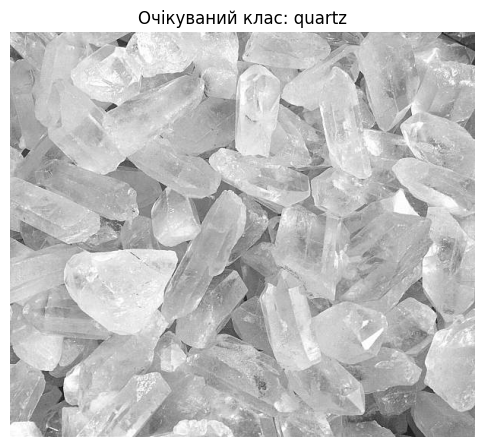

Model_EXP1: pyrite (Неправильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0164.jpg
Очікуваний клас: bornite


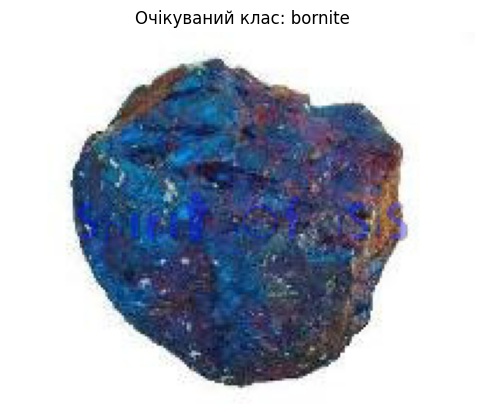

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: chrysocolla (Неправильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0074.jpg
Очікуваний клас: chrysocolla


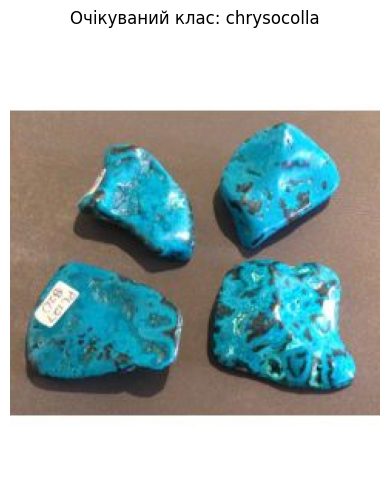

Model_EXP1: chrysocolla (Правильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0061.jpg
Очікуваний клас: malachite


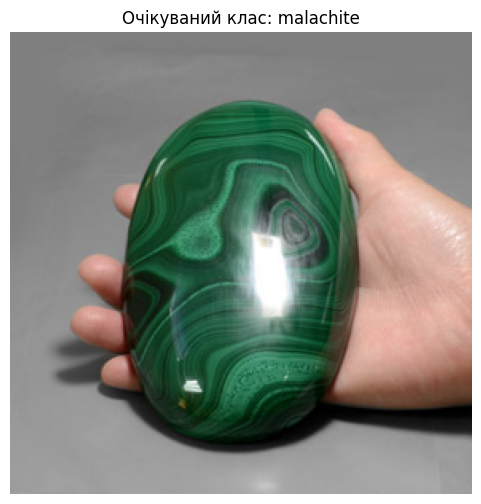

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0159.jpg
Очікуваний клас: bornite


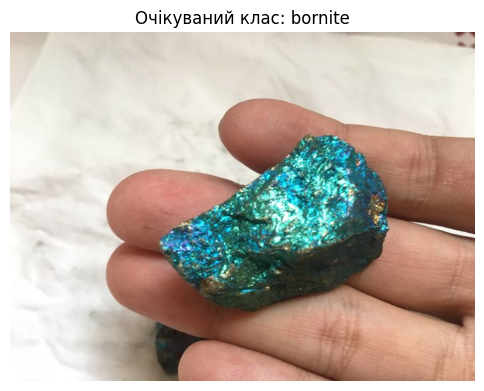

Model_EXP1: chrysocolla (Неправильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0028.jpg
Очікуваний клас: quartz


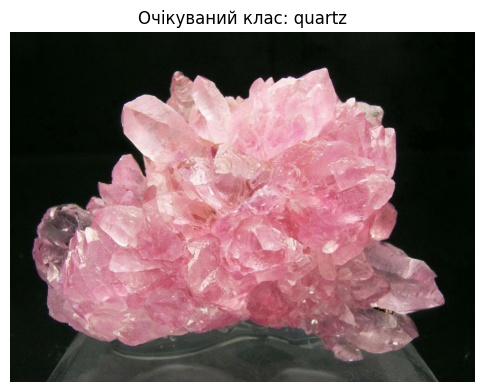

Model_EXP1: quartz (Правильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: muscovite (Неправильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0138.jpg
Очікуваний клас: quartz


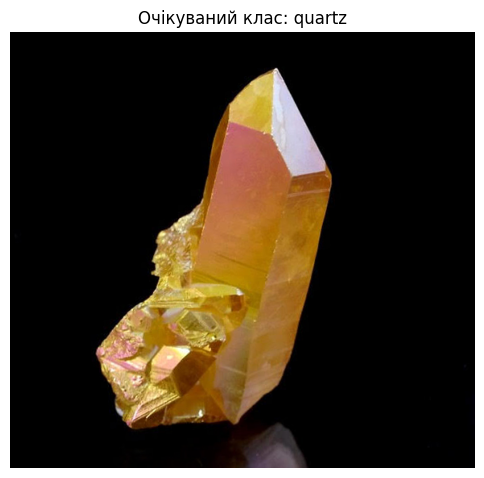

Model_EXP1: chrysocolla (Неправильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: pyrite (Неправильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0110.jpg
Очікуваний клас: quartz


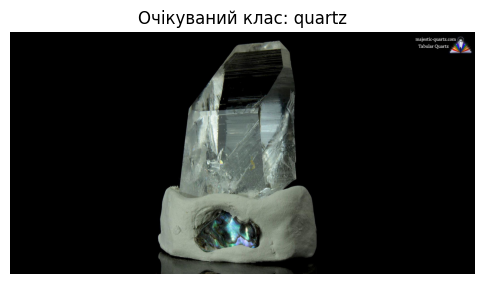

Model_EXP1: chrysocolla (Неправильно)
Model_EXP2: malachite (Неправильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: pyrite (Неправильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0018.jpg
Очікуваний клас: malachite


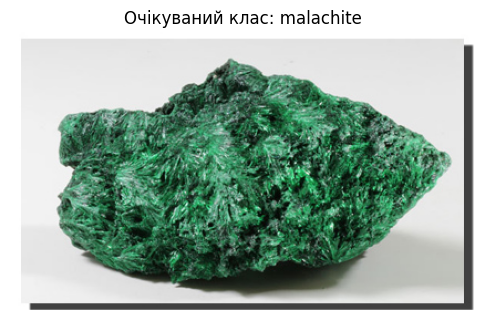

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0044.jpg
Очікуваний клас: chrysocolla


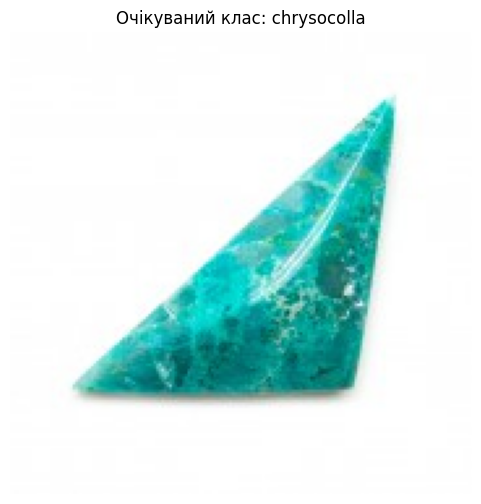

Model_EXP1: malachite (Неправильно)
Model_EXP2: malachite (Неправильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/muscovite/0001.jpg
Очікуваний клас: muscovite


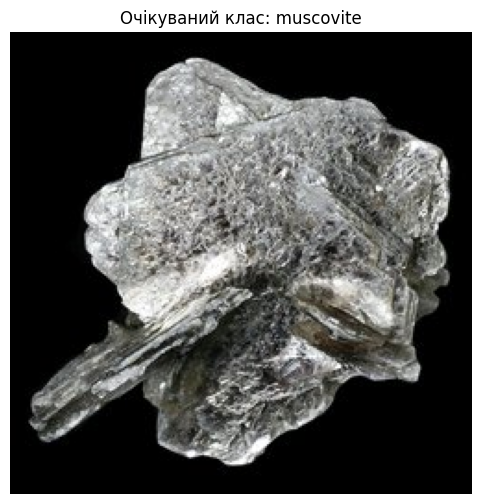

Model_EXP1: muscovite (Правильно)
Model_EXP2: muscovite (Правильно)
Model_EXP3: muscovite (Правильно)
Model_EXP4: muscovite (Правильно)
Model_EXP5: muscovite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0035.jpg
Очікуваний клас: bornite


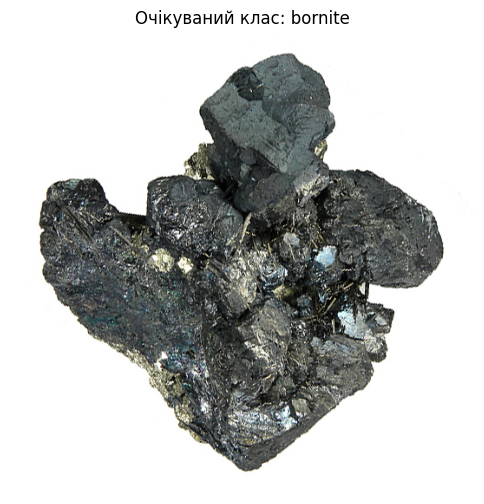

Model_EXP1: pyrite (Неправильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: pyrite (Неправильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0021.jpg
Очікуваний клас: malachite


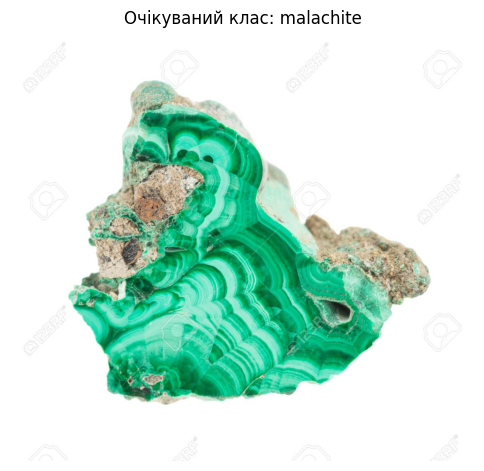

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/0058.jpg
Очікуваний клас: pyrite


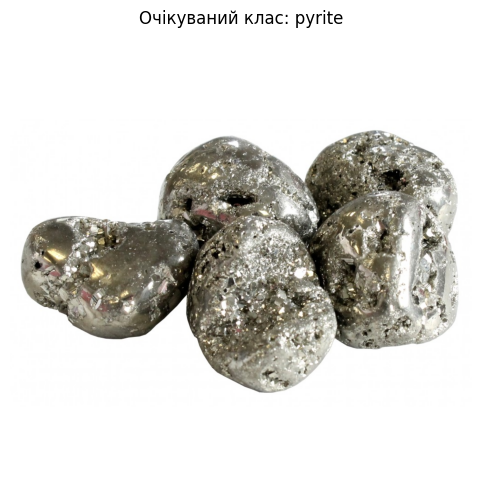

Model_EXP1: bornite (Неправильно)
Model_EXP2: pyrite (Правильно)
Model_EXP3: pyrite (Правильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: pyrite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0078.jpg
Очікуваний клас: malachite


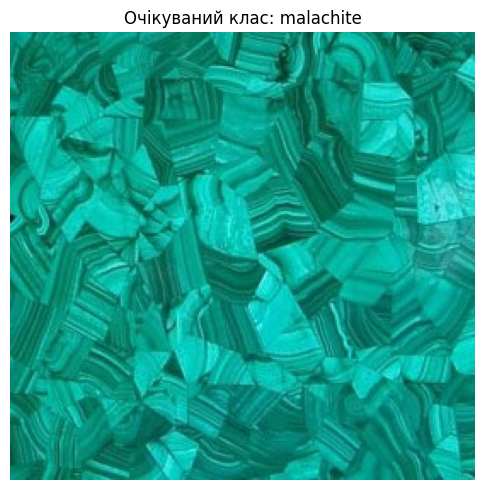

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/76. 104-pyrite.png
Очікуваний клас: pyrite


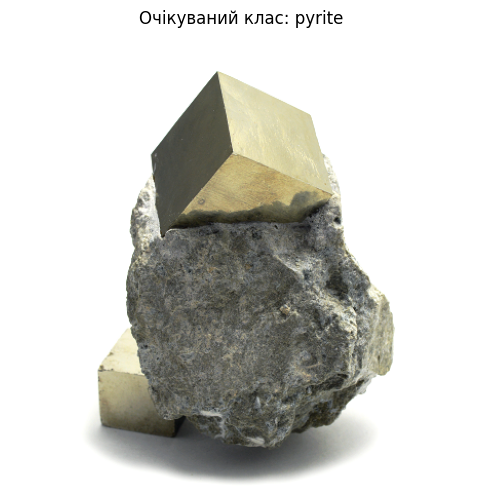

Model_EXP1: bornite (Неправильно)
Model_EXP2: pyrite (Правильно)
Model_EXP3: pyrite (Правильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: biotite (Неправильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0056.jpg
Очікуваний клас: bornite


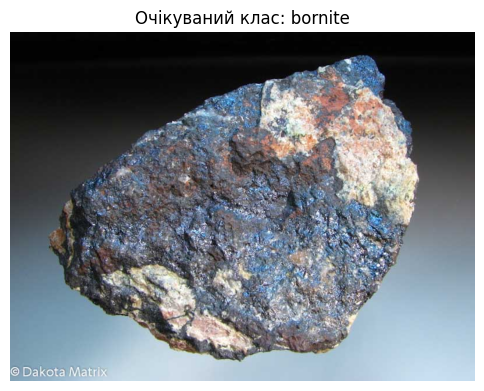

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/0091.jpg
Очікуваний клас: pyrite


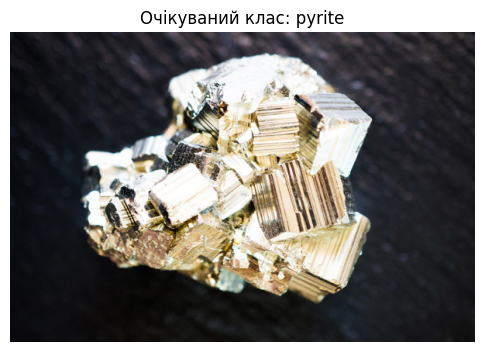

Model_EXP1: muscovite (Неправильно)
Model_EXP2: pyrite (Правильно)
Model_EXP3: pyrite (Правильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: pyrite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0025.jpg
Очікуваний клас: malachite


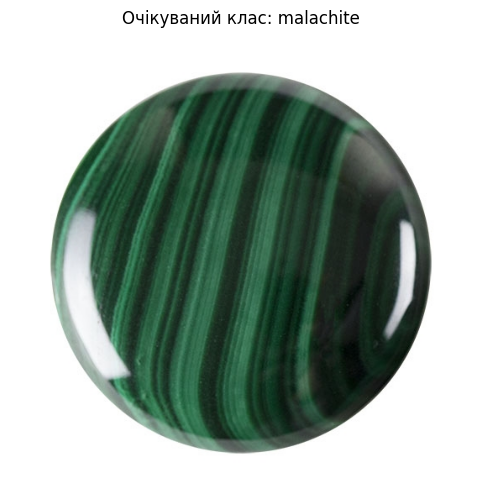

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0093.jpg
Очікуваний клас: quartz


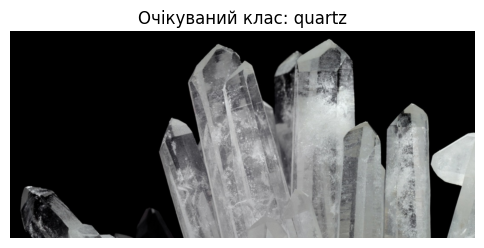

Model_EXP1: malachite (Неправильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/biotite/0064.jpg
Очікуваний клас: biotite


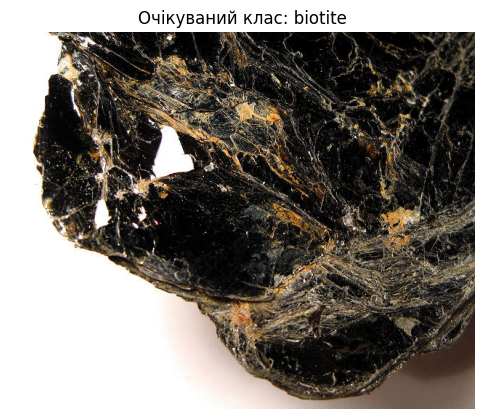

Model_EXP1: chrysocolla (Неправильно)
Model_EXP2: bornite (Неправильно)
Model_EXP3: biotite (Правильно)
Model_EXP4: biotite (Правильно)
Model_EXP5: biotite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0155.jpg
Очікуваний клас: malachite


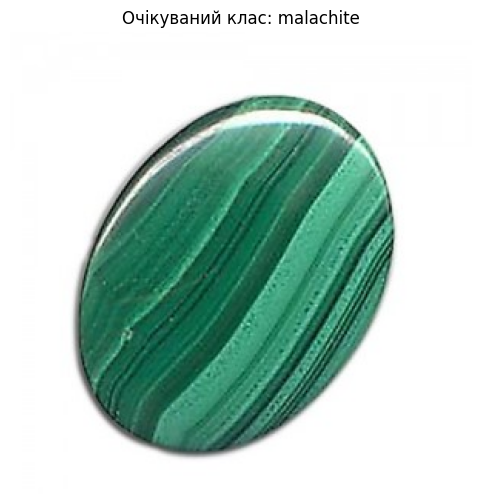

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0186.jpg
Очікуваний клас: malachite


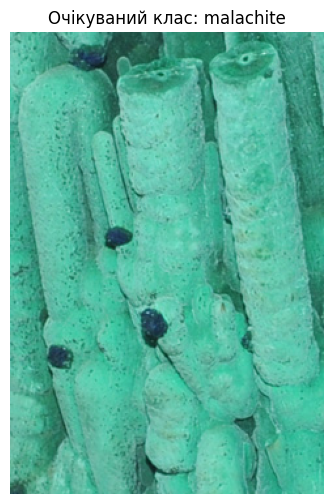

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: chrysocolla (Неправильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0022.jpg
Очікуваний клас: bornite


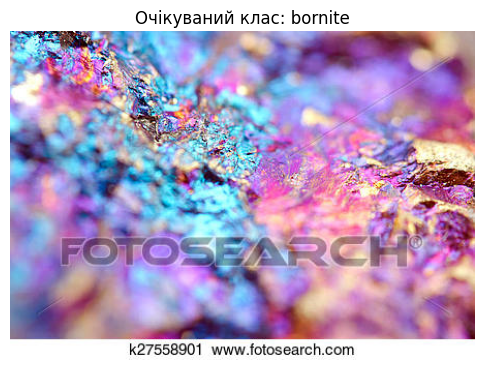

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/biotite/0057.jpg
Очікуваний клас: biotite


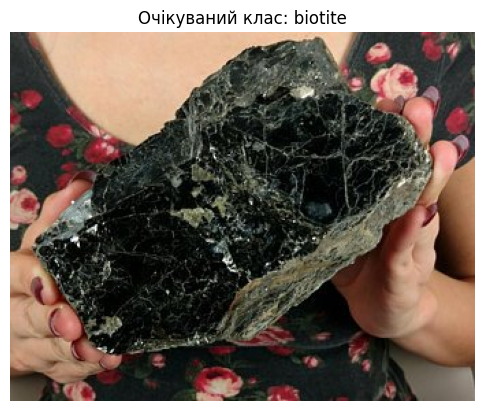

Model_EXP1: bornite (Неправильно)
Model_EXP2: bornite (Неправильно)
Model_EXP3: biotite (Правильно)
Model_EXP4: biotite (Правильно)
Model_EXP5: biotite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0007.jpg
Очікуваний клас: quartz


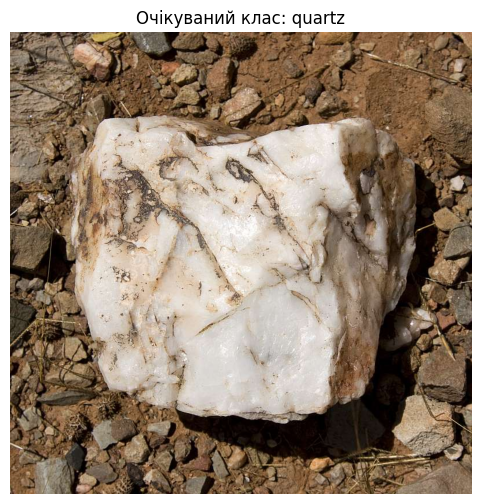

Model_EXP1: quartz (Правильно)
Model_EXP2: muscovite (Неправильно)
Model_EXP3: muscovite (Неправильно)
Model_EXP4: muscovite (Неправильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0107.jpg
Очікуваний клас: quartz


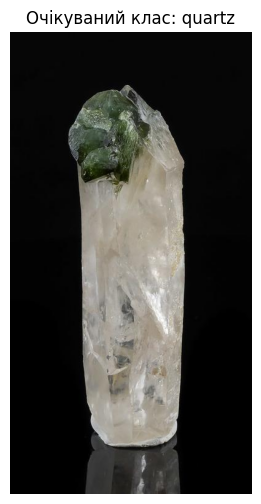

Model_EXP1: quartz (Правильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/biotite/0025.jpg
Очікуваний клас: biotite


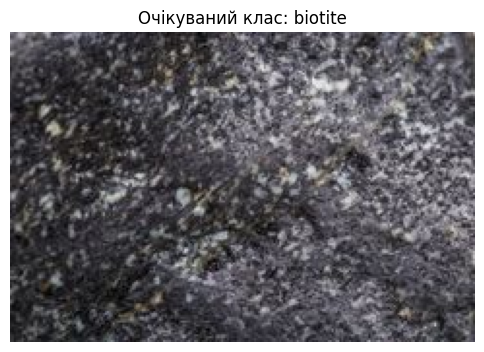

Model_EXP1: pyrite (Неправильно)
Model_EXP2: malachite (Неправильно)
Model_EXP3: biotite (Правильно)
Model_EXP4: biotite (Правильно)
Model_EXP5: biotite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/muscovite/0074.jpg
Очікуваний клас: muscovite


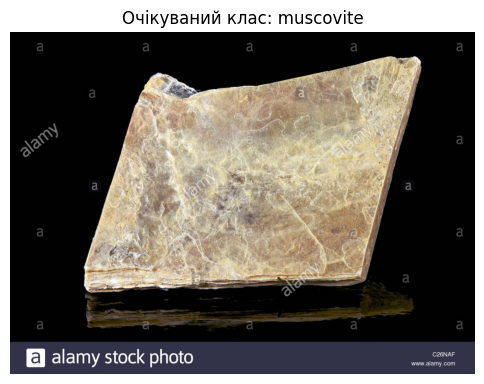

Model_EXP1: malachite (Неправильно)
Model_EXP2: muscovite (Правильно)
Model_EXP3: muscovite (Правильно)
Model_EXP4: muscovite (Правильно)
Model_EXP5: muscovite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0031.jpg
Очікуваний клас: quartz


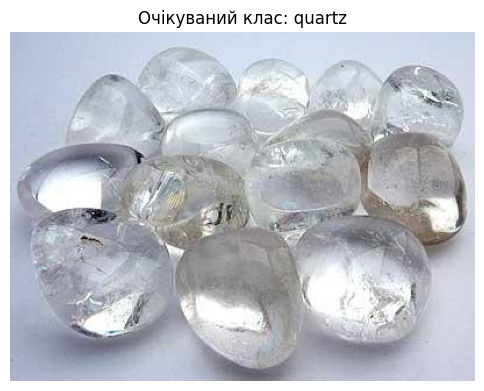

Model_EXP1: malachite (Неправильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/biotite/0038.jpg
Очікуваний клас: biotite


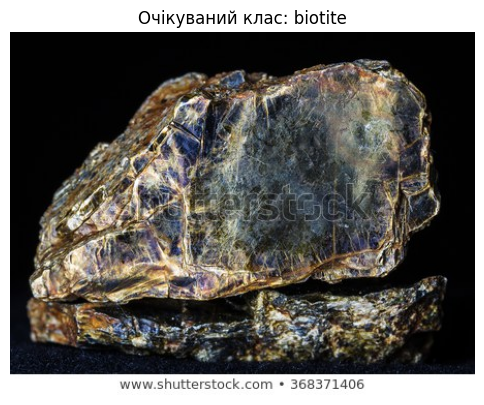

Model_EXP1: bornite (Неправильно)
Model_EXP2: muscovite (Неправильно)
Model_EXP3: biotite (Правильно)
Model_EXP4: biotite (Правильно)
Model_EXP5: biotite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/biotite/0058.jpg
Очікуваний клас: biotite


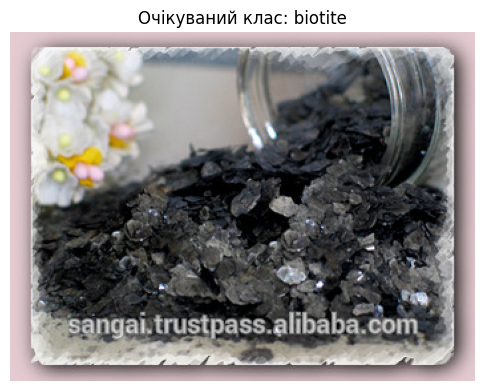

Model_EXP1: malachite (Неправильно)
Model_EXP2: chrysocolla (Неправильно)
Model_EXP3: biotite (Правильно)
Model_EXP4: biotite (Правильно)
Model_EXP5: biotite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0049.jpg
Очікуваний клас: chrysocolla


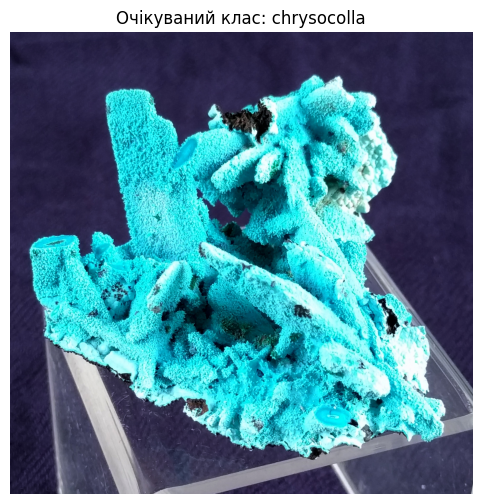

Model_EXP1: chrysocolla (Правильно)
Model_EXP2: malachite (Неправильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/muscovite/0022.jpg
Очікуваний клас: muscovite


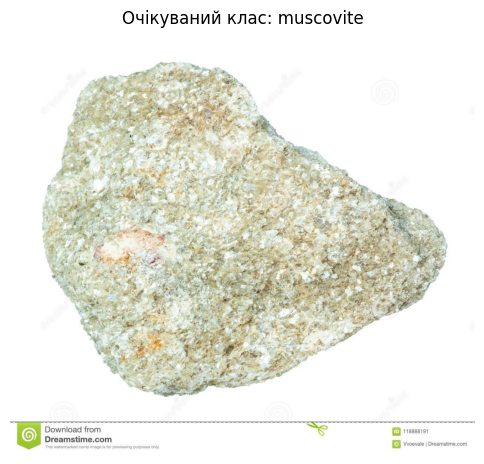

Model_EXP1: bornite (Неправильно)
Model_EXP2: bornite (Неправильно)
Model_EXP3: quartz (Неправильно)
Model_EXP4: pyrite (Неправильно)
Model_EXP5: muscovite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/0011.jpg
Очікуваний клас: pyrite


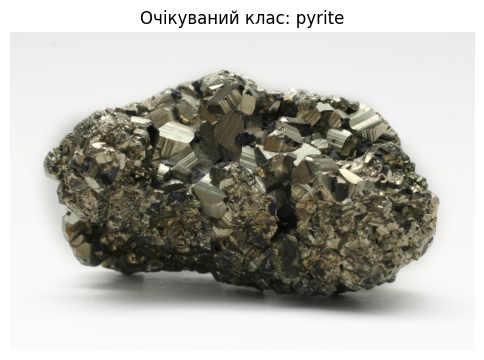

Model_EXP1: pyrite (Правильно)
Model_EXP2: pyrite (Правильно)
Model_EXP3: pyrite (Правильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: pyrite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0075.jpg
Очікуваний клас: malachite


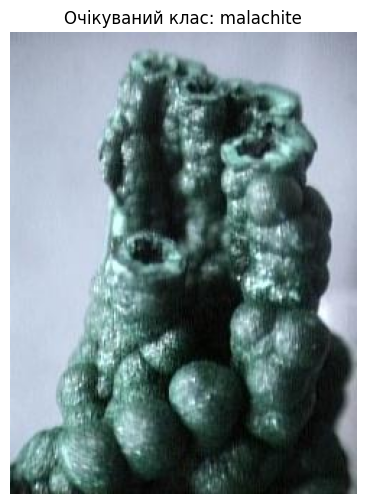

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0199.jpg
Очікуваний клас: malachite


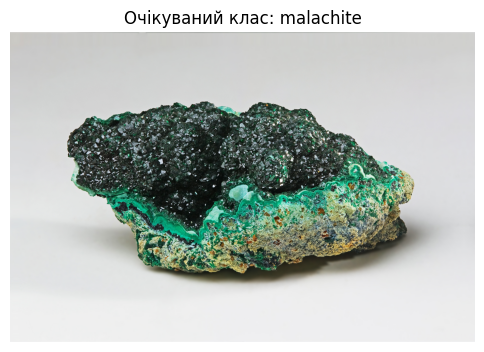

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: bornite (Неправильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0110.jpg
Очікуваний клас: malachite


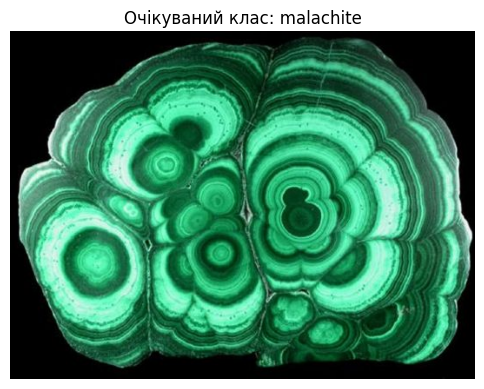

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0121.jpg
Очікуваний клас: quartz


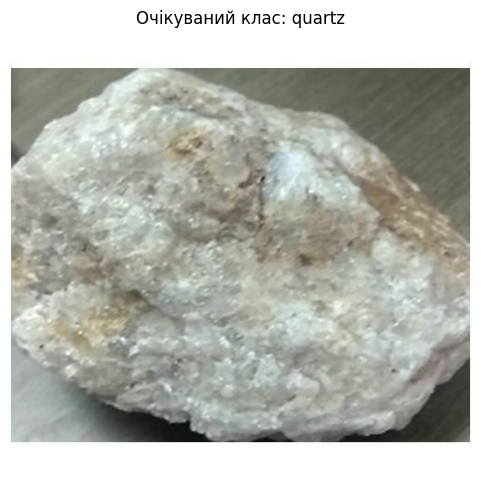

Model_EXP1: quartz (Правильно)
Model_EXP2: muscovite (Неправильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/34. chrysocolla-turquoise-2.png
Очікуваний клас: chrysocolla


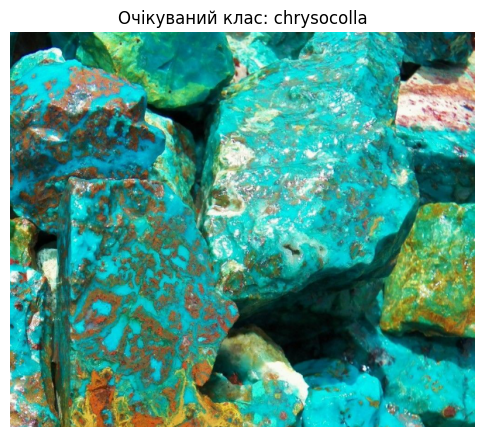

Model_EXP1: bornite (Неправильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/muscovite/0059.jpg
Очікуваний клас: muscovite


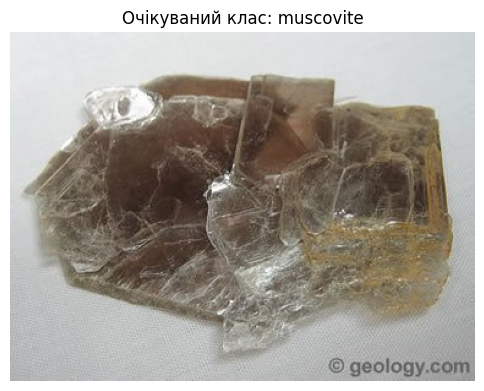

Model_EXP1: quartz (Неправильно)
Model_EXP2: muscovite (Правильно)
Model_EXP3: muscovite (Правильно)
Model_EXP4: muscovite (Правильно)
Model_EXP5: muscovite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0004.jpg
Очікуваний клас: quartz


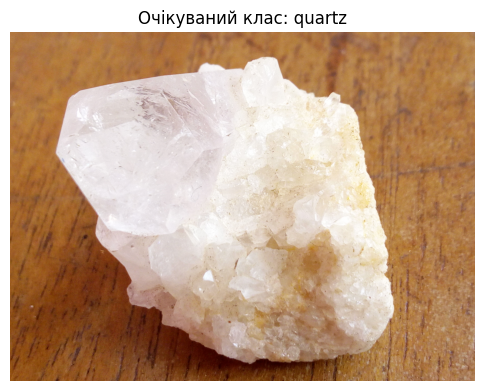

Model_EXP1: quartz (Правильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0113.jpg
Очікуваний клас: quartz


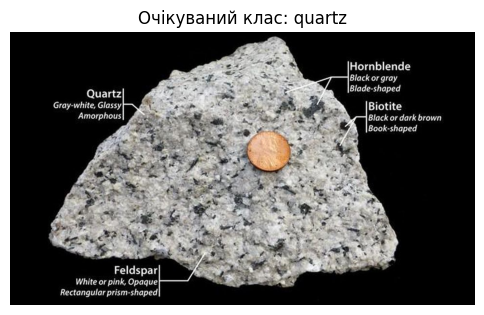

Model_EXP1: chrysocolla (Неправильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0144.jpg
Очікуваний клас: chrysocolla


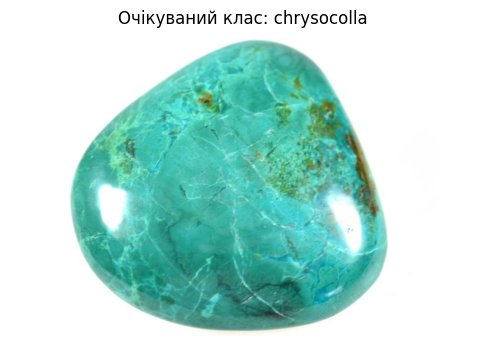

Model_EXP1: malachite (Неправильно)
Model_EXP2: malachite (Неправильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0145.jpg
Очікуваний клас: bornite


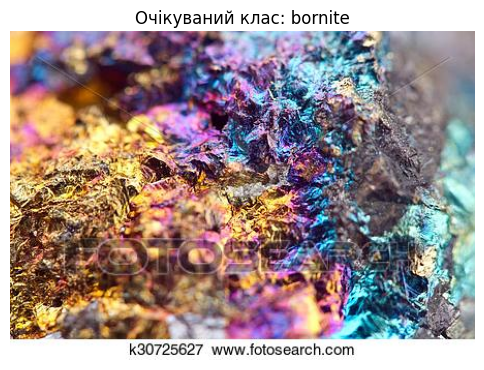

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/0053.jpg
Очікуваний клас: pyrite


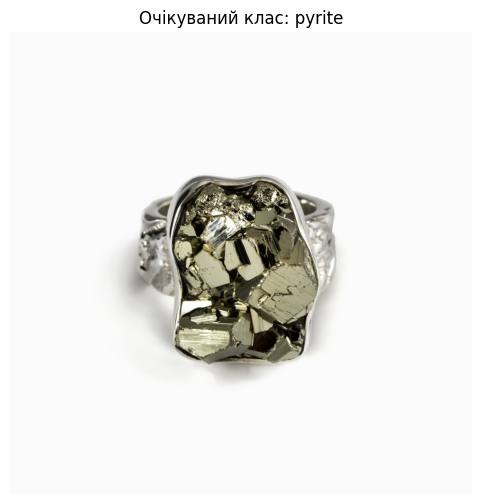

Model_EXP1: pyrite (Правильно)
Model_EXP2: pyrite (Правильно)
Model_EXP3: pyrite (Правильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: pyrite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0131.jpg
Очікуваний клас: chrysocolla


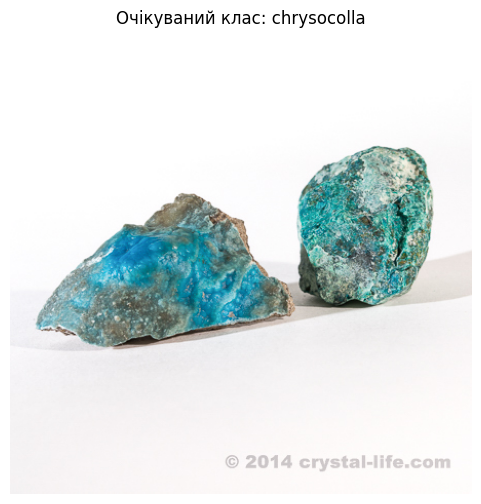

Model_EXP1: bornite (Неправильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0066.jpg
Очікуваний клас: bornite


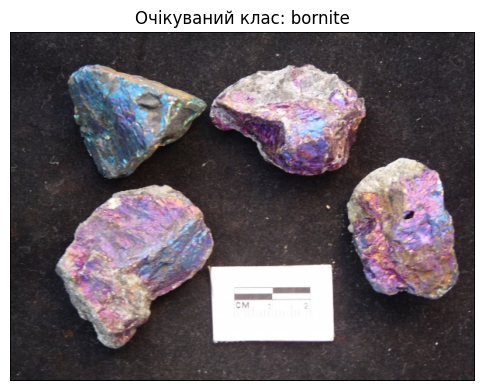

Model_EXP1: malachite (Неправильно)
Model_EXP2: chrysocolla (Неправильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0123.jpg
Очікуваний клас: chrysocolla


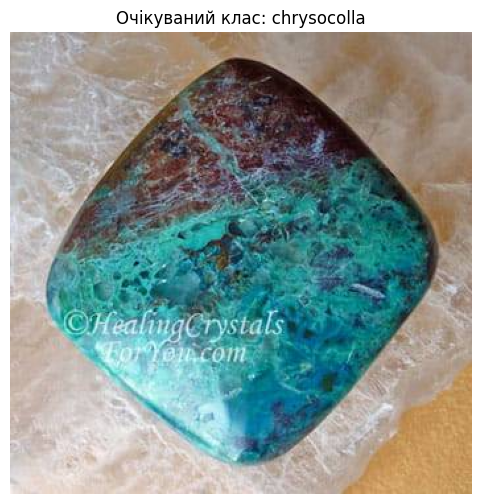

Model_EXP1: bornite (Неправильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0105.jpg
Очікуваний клас: chrysocolla


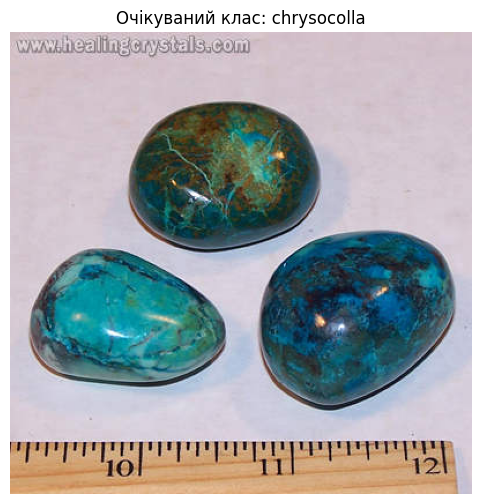

Model_EXP1: chrysocolla (Правильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0169.jpg
Очікуваний клас: malachite


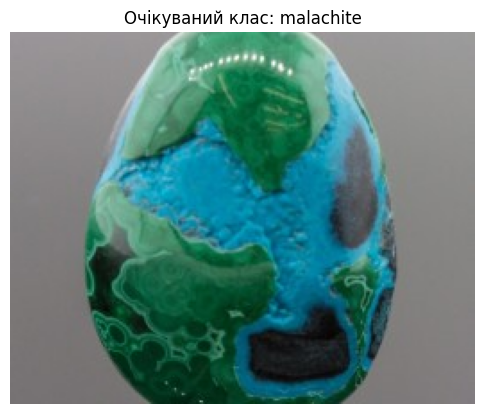

Model_EXP1: chrysocolla (Неправильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0039.jpg
Очікуваний клас: quartz


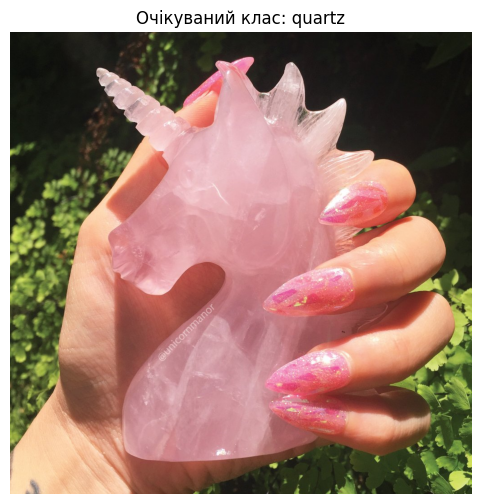

Model_EXP1: quartz (Правильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0048.jpg
Очікуваний клас: bornite


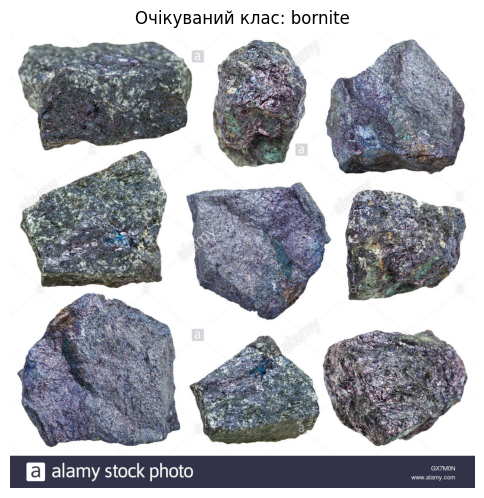

Model_EXP1: malachite (Неправильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0089.jpg
Очікуваний клас: bornite


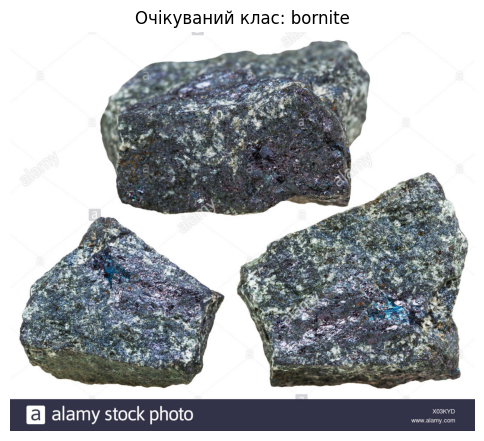

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/0004.jpg
Очікуваний клас: pyrite


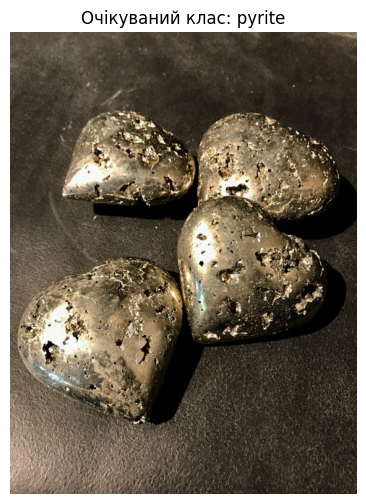

Model_EXP1: malachite (Неправильно)
Model_EXP2: pyrite (Правильно)
Model_EXP3: pyrite (Правильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: pyrite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0125.jpg
Очікуваний клас: malachite


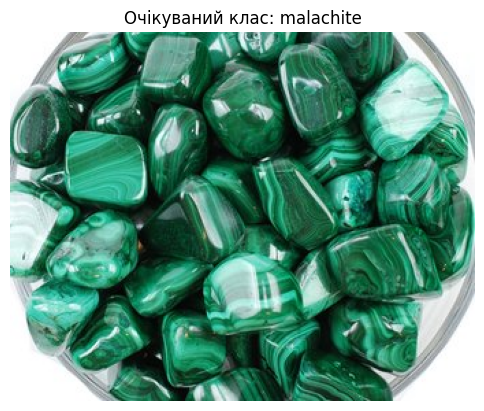

Model_EXP1: biotite (Неправильно)
Model_EXP2: chrysocolla (Неправильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/0055.jpg
Очікуваний клас: pyrite


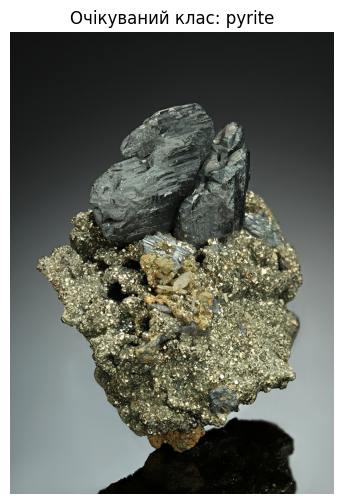

Model_EXP1: pyrite (Правильно)
Model_EXP2: pyrite (Правильно)
Model_EXP3: pyrite (Правильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: pyrite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0005.jpg
Очікуваний клас: bornite


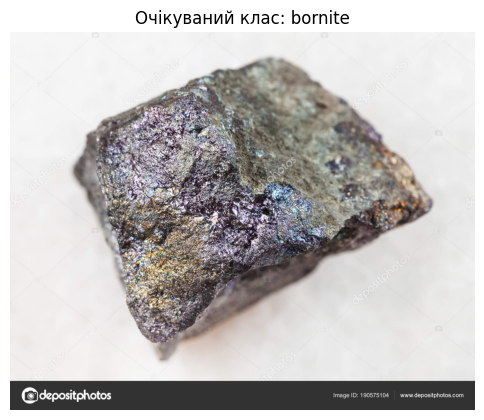

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0084.jpg
Очікуваний клас: malachite


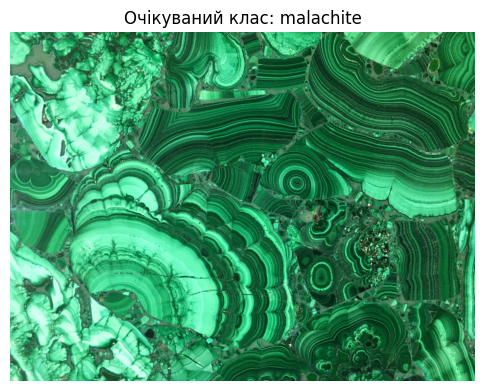

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0051.jpg
Очікуваний клас: bornite


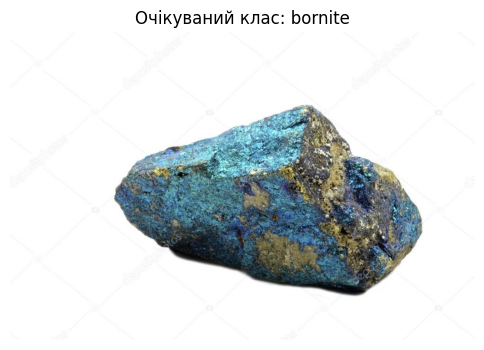

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0066.jpg
Очікуваний клас: malachite


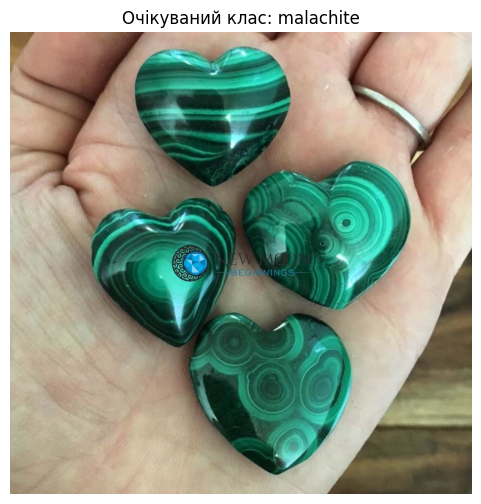

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0002.jpg
Очікуваний клас: chrysocolla


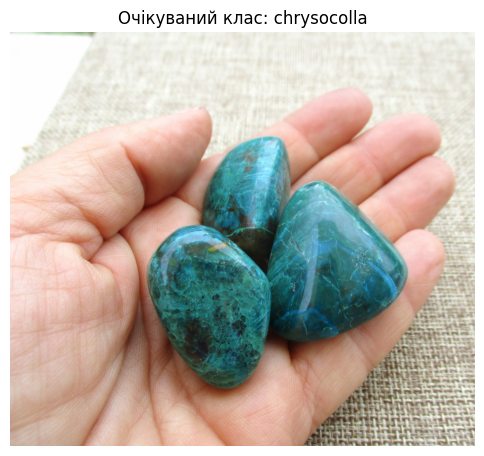

Model_EXP1: chrysocolla (Правильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0013.jpg
Очікуваний клас: malachite


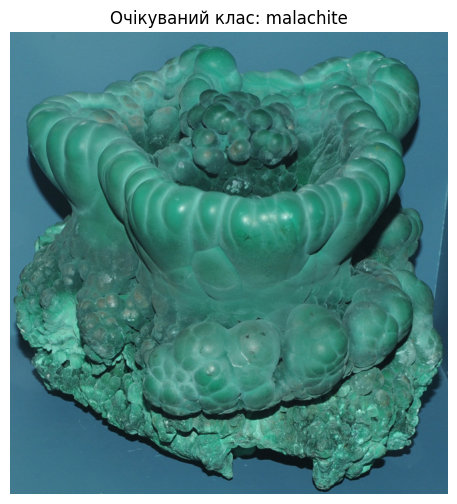

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0146.jpg
Очікуваний клас: malachite


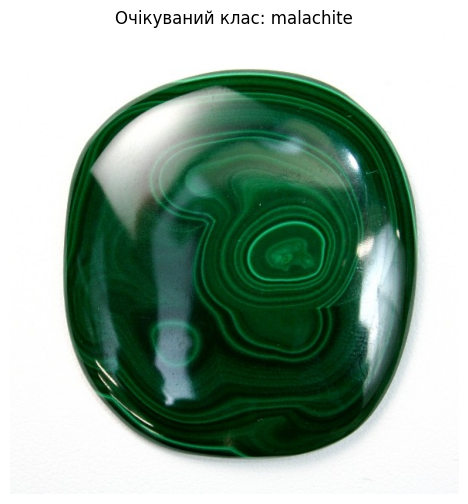

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/114. bornite.gif
Очікуваний клас: bornite


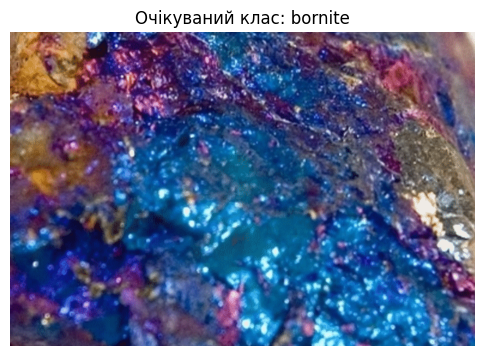

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0033.jpg
Очікуваний клас: quartz


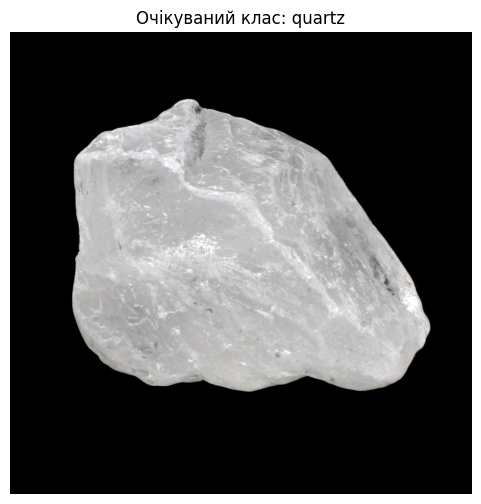

Model_EXP1: quartz (Правильно)
Model_EXP2: muscovite (Неправильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0011.jpg
Очікуваний клас: malachite


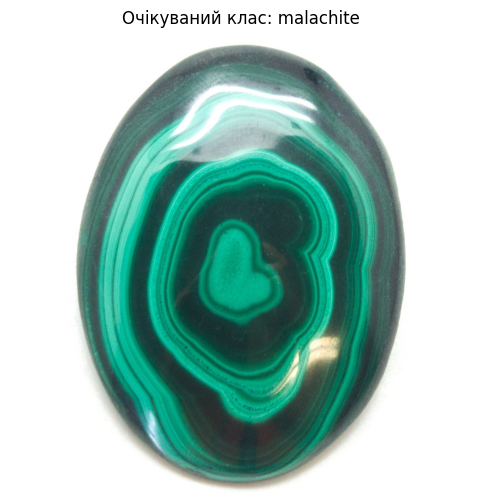

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0075.jpg
Очікуваний клас: bornite


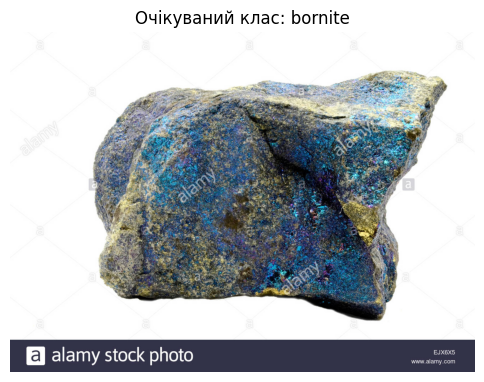

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/muscovite/0017.jpg
Очікуваний клас: muscovite


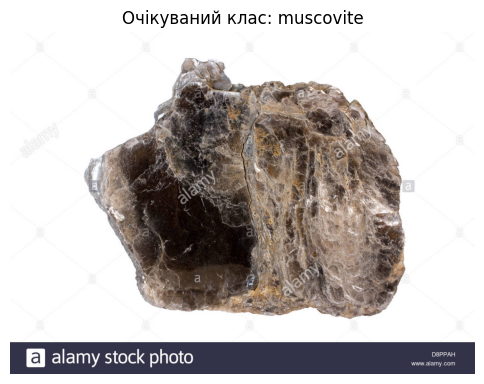

Model_EXP1: bornite (Неправильно)
Model_EXP2: muscovite (Правильно)
Model_EXP3: muscovite (Правильно)
Model_EXP4: muscovite (Правильно)
Model_EXP5: muscovite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0046.jpg
Очікуваний клас: bornite


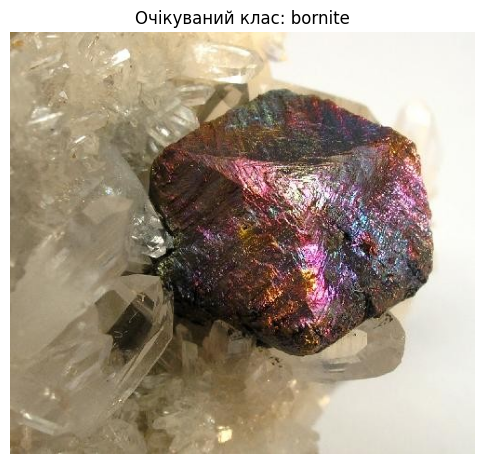

Model_EXP1: chrysocolla (Неправильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0014.jpg
Очікуваний клас: bornite


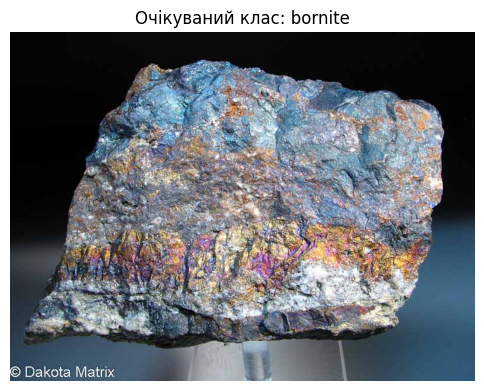

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0058.jpg
Очікуваний клас: quartz


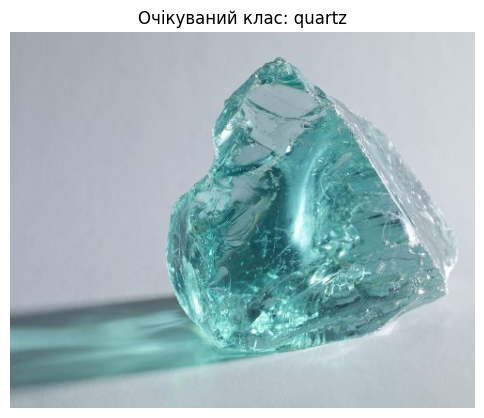

Model_EXP1: quartz (Правильно)
Model_EXP2: malachite (Неправильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0040.jpg
Очікуваний клас: bornite


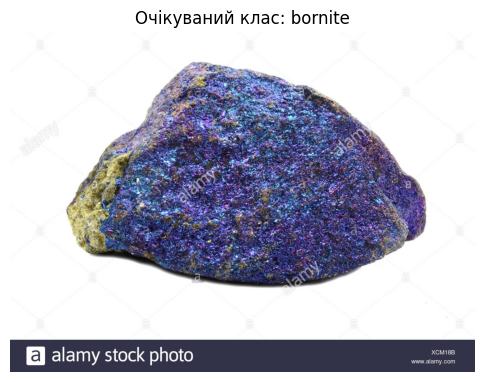

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/muscovite/0039.jpg
Очікуваний клас: muscovite


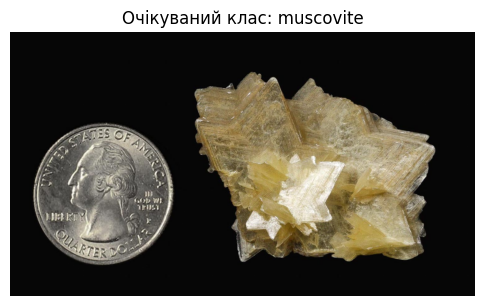

Model_EXP1: quartz (Неправильно)
Model_EXP2: muscovite (Правильно)
Model_EXP3: muscovite (Правильно)
Model_EXP4: muscovite (Правильно)
Model_EXP5: muscovite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/0075.jpg
Очікуваний клас: pyrite


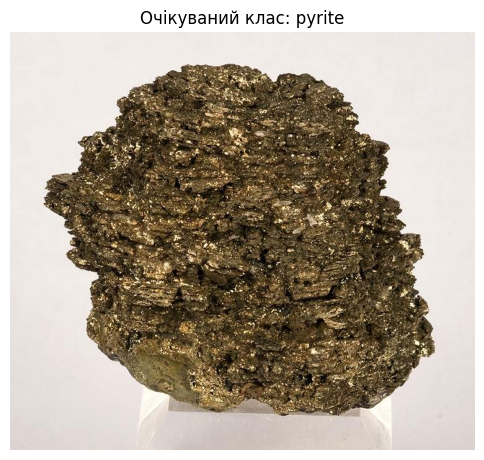

Model_EXP1: pyrite (Правильно)
Model_EXP2: pyrite (Правильно)
Model_EXP3: pyrite (Правильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: pyrite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0007.jpg
Очікуваний клас: bornite


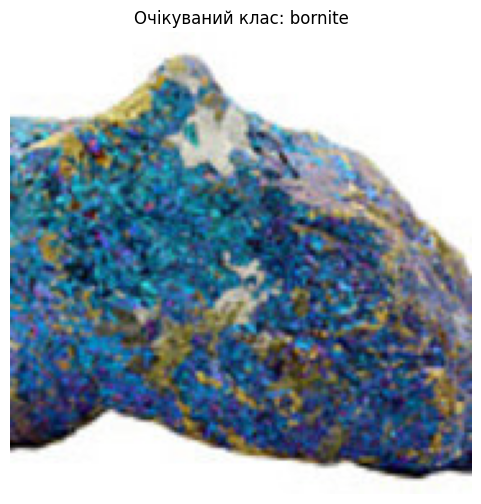

Model_EXP1: malachite (Неправильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0145.jpg
Очікуваний клас: malachite


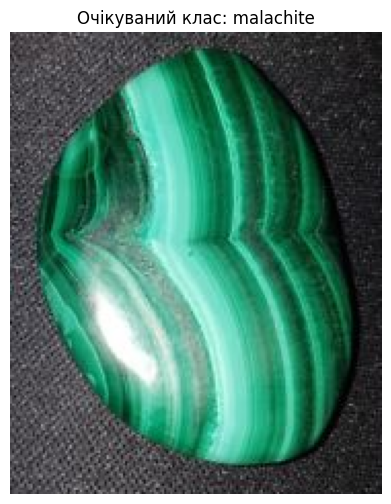

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/biotite/0023.jpg
Очікуваний клас: biotite


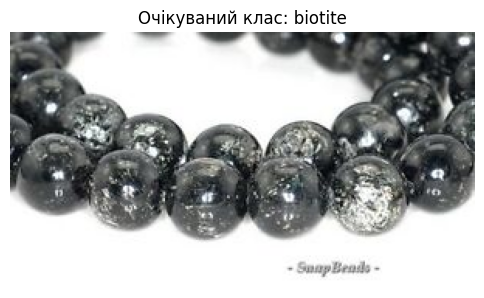

Model_EXP1: biotite (Правильно)
Model_EXP2: biotite (Правильно)
Model_EXP3: biotite (Правильно)
Model_EXP4: biotite (Правильно)
Model_EXP5: biotite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0072.jpg
Очікуваний клас: bornite


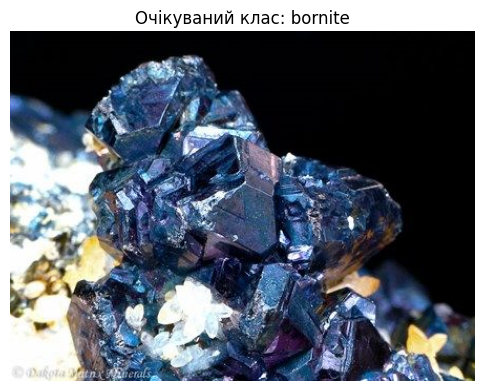

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: pyrite (Неправильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0217.jpg
Очікуваний клас: malachite


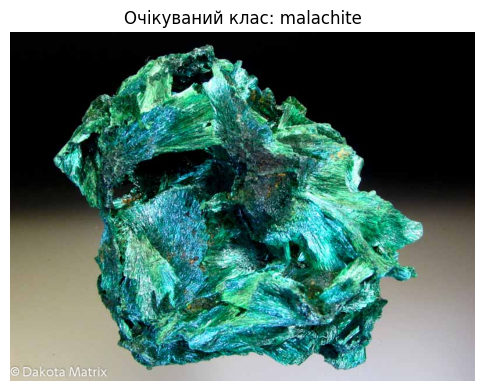

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0140.jpg
Очікуваний клас: bornite


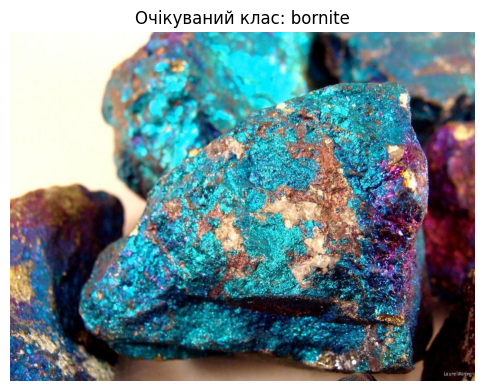

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0161.jpg
Очікуваний клас: bornite


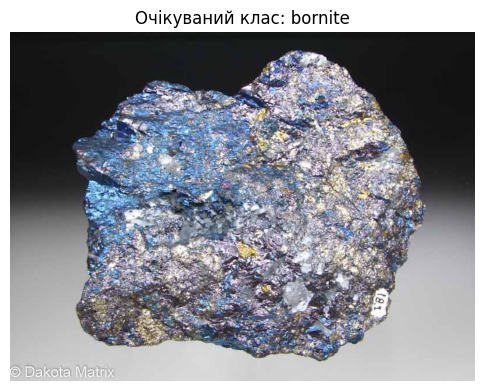

Model_EXP1: bornite (Правильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: bornite (Правильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0059.jpg
Очікуваний клас: malachite


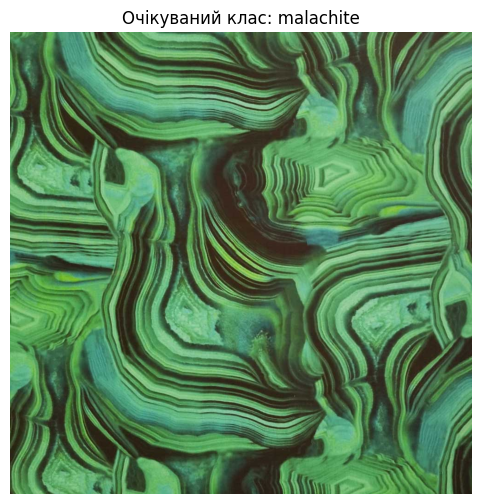

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/muscovite/0060.jpg
Очікуваний клас: muscovite


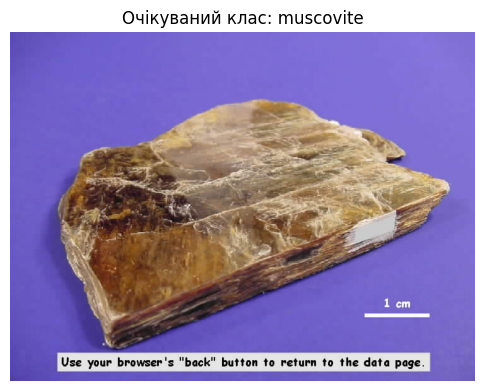

Model_EXP1: quartz (Неправильно)
Model_EXP2: muscovite (Правильно)
Model_EXP3: muscovite (Правильно)
Model_EXP4: muscovite (Правильно)
Model_EXP5: muscovite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0156.jpg
Очікуваний клас: malachite


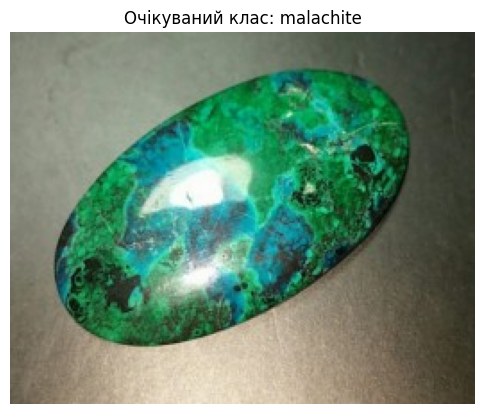

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0228.jpg
Очікуваний клас: malachite


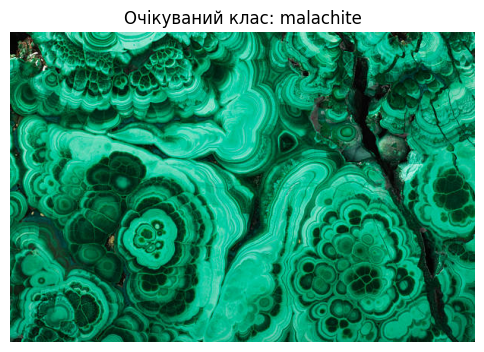

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0156.jpg
Очікуваний клас: chrysocolla


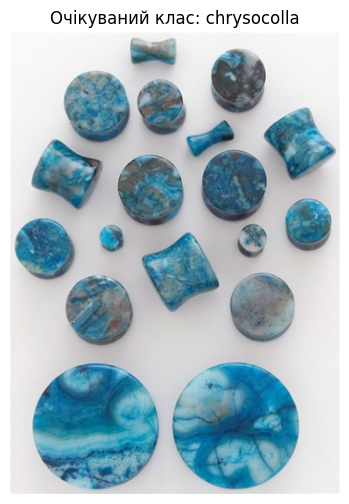

Model_EXP1: malachite (Неправильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/quartz/0008.jpg
Очікуваний клас: quartz


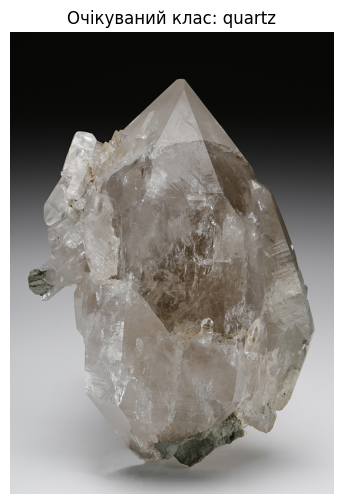

Model_EXP1: quartz (Правильно)
Model_EXP2: quartz (Правильно)
Model_EXP3: quartz (Правильно)
Model_EXP4: quartz (Правильно)
Model_EXP5: quartz (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/biotite/0028.jpg
Очікуваний клас: biotite


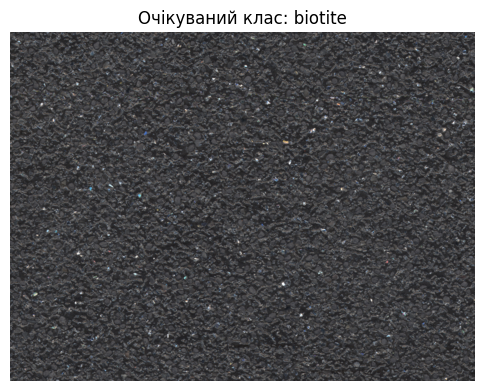

Model_EXP1: pyrite (Неправильно)
Model_EXP2: malachite (Неправильно)
Model_EXP3: biotite (Правильно)
Model_EXP4: biotite (Правильно)
Model_EXP5: biotite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0016.jpg
Очікуваний клас: chrysocolla


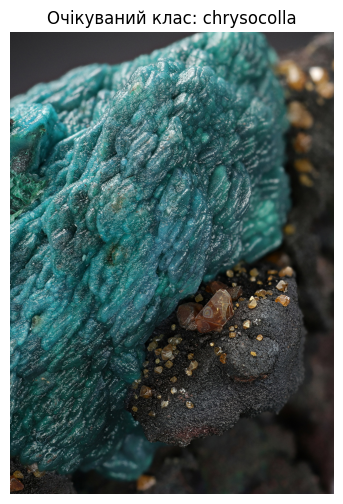

Model_EXP1: bornite (Неправильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: malachite (Неправильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0151.jpg
Очікуваний клас: chrysocolla


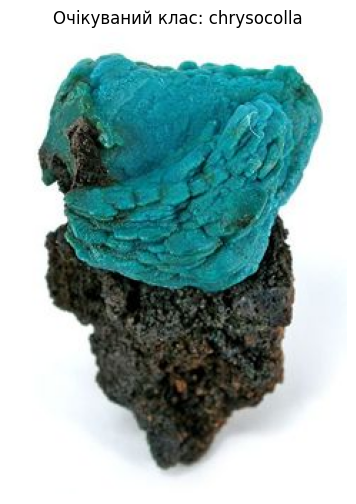

Model_EXP1: malachite (Неправильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0035.jpg
Очікуваний клас: chrysocolla


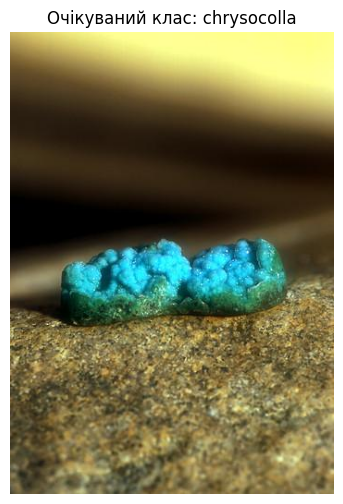

Model_EXP1: chrysocolla (Правильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0128.jpg
Очікуваний клас: malachite


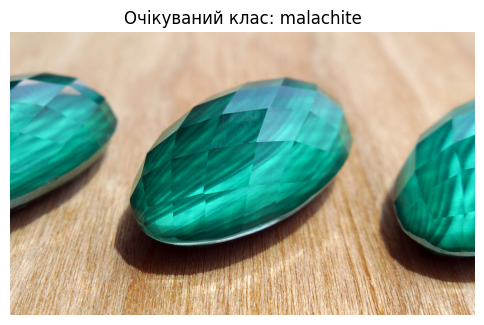

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0086.jpg
Очікуваний клас: chrysocolla


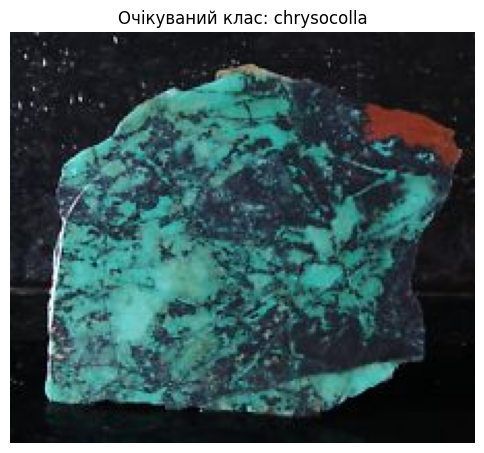

Model_EXP1: quartz (Неправильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/pyrite/0052.jpg
Очікуваний клас: pyrite


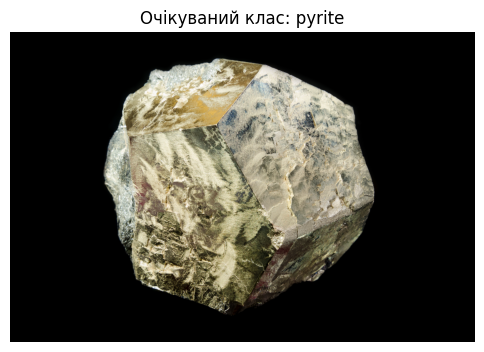

Model_EXP1: bornite (Неправильно)
Model_EXP2: muscovite (Неправильно)
Model_EXP3: muscovite (Неправильно)
Model_EXP4: pyrite (Правильно)
Model_EXP5: muscovite (Неправильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0096.jpg
Очікуваний клас: malachite


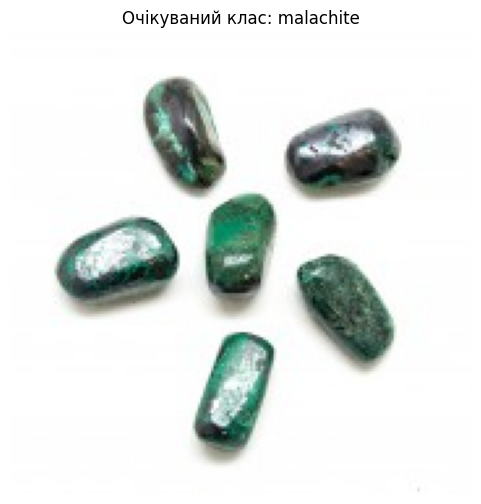

Model_EXP1: malachite (Правильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: bornite (Неправильно)
--------------------------------------------------
Файл: minerals_gen/test/bornite/0055.jpg
Очікуваний клас: bornite


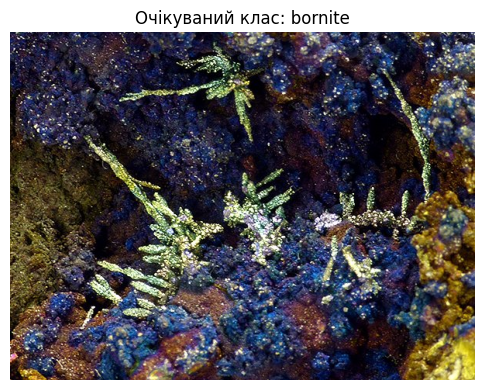

Model_EXP1: pyrite (Неправильно)
Model_EXP2: bornite (Правильно)
Model_EXP3: biotite (Неправильно)
Model_EXP4: bornite (Правильно)
Model_EXP5: bornite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/malachite/0159.jpg
Очікуваний клас: malachite


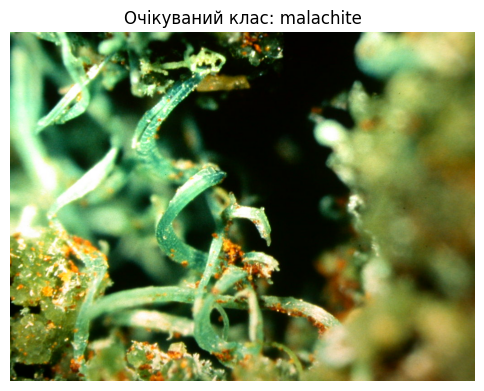

Model_EXP1: bornite (Неправильно)
Model_EXP2: malachite (Правильно)
Model_EXP3: malachite (Правильно)
Model_EXP4: malachite (Правильно)
Model_EXP5: malachite (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/chrysocolla/0061.jpg
Очікуваний клас: chrysocolla


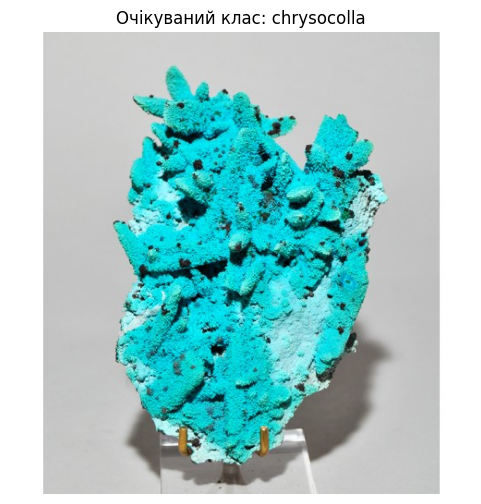

Model_EXP1: chrysocolla (Правильно)
Model_EXP2: chrysocolla (Правильно)
Model_EXP3: chrysocolla (Правильно)
Model_EXP4: chrysocolla (Правильно)
Model_EXP5: chrysocolla (Правильно)
--------------------------------------------------
Файл: minerals_gen/test/biotite/0055.jpg
Очікуваний клас: biotite


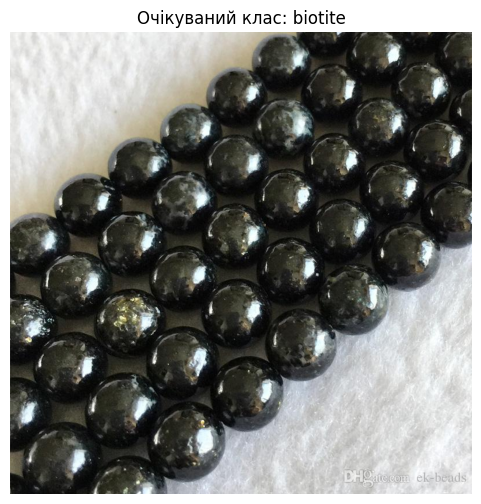

Model_EXP1: malachite (Неправильно)
Model_EXP2: biotite (Правильно)
Model_EXP3: biotite (Правильно)
Model_EXP4: biotite (Правильно)
Model_EXP5: biotite (Правильно)
--------------------------------------------------

Підсумкові результати:
Model_EXP1: 57 правильних передбачень (57.00% точності)
Model_EXP2: 82 правильних передбачень (82.00% точності)
Model_EXP3: 95 правильних передбачень (95.00% точності)
Model_EXP4: 91 правильних передбачень (91.00% точності)
Model_EXP5: 96 правильних передбачень (96.00% точності)


In [12]:
# Тестування моделей
input_sizes = [(150, 150), (150, 150), (299, 299), (299, 299), (299, 299)]  # Розмірності для моделей
test_mushrooms_from_test_set(models, class_names, test_dir, input_sizes, num_samples=100)